In [377]:
from scipy import integrate, sparse
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation, rcParams
from IPython.display import HTML

from numba import jit, njit

In [382]:
#initial conditions
x_max = 40
midpt = x_max/2
dx = .01
x = np.linspace(0, x_max, int(x_max/dx))

kx = .1
m = 1
sigma = .1
#x0 = x_max/3
x0 = midpt - 2
hbar = 1

A = 1/(sigma * np.sqrt(np.pi)) # normalization factor


Total Probability psi0:  0.9998571428571409
Total Probability psi02:  0.9998571428571409


c:\Users\natha\anaconda3\lib\site-packages\matplotlib\animation.py:887: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you have outputted the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(


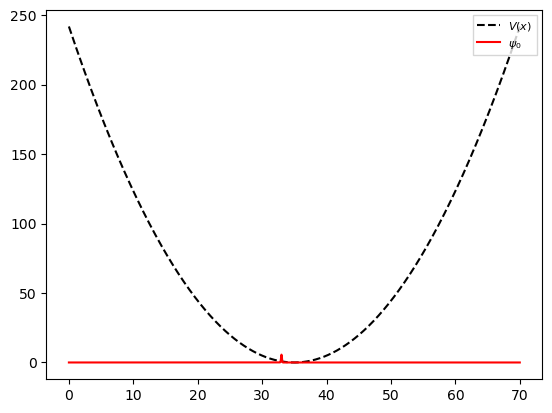

In [383]:
#initial wavefxn and potential
psi0 = np.sqrt(A) * np.exp(-((x-x0)**2)/(2*sigma**2))*np.exp(1j * kx * x)
psi02 = np.sqrt(A) * np.exp(-((x-x0)**2)/(2*sigma**2))*np.exp(1j * 500*kx * x)


T = 1 #period

omega = 2*np.pi/T
k = omega**2 * m
V = 0.5 * k * (x-midpt)**2 #SHO potential
V2 = np.piecewise(x, [x < midpt, x >= midpt], [0, 1000]) #step potential
V3 = np.piecewise(x, [x < midpt, x >= midpt], [0, -1000]) #step potential
Vslant = np.piecewise(x, [x < midpt, x >= midpt], [0, lambda x: 100*(x-midpt)])


plt.plot(x, V*0.01, "k--", label=r"$V(x)$")
plt.plot(x, np.abs(psi0)**2, "r", label=r"$\psi_0$")
plt.legend(loc=1, fontsize=8, fancybox=False)
print("Total Probability psi0: ", np.sum(np.abs(psi0)**2)*dx)
print("Total Probability psi02: ", np.sum(np.abs(psi02)**2)*dx)

In [380]:
#2nd deriv
D2 = sparse.diags([1, -2, 1], [-1, 0, 1], shape=(len(x), len(x))) / dx**2

In [384]:
#RHS of shro eqn
def psi_t(t, psi):
    return -1j * (-hbar**2/(2*m) * D2.dot(psi) + V*psi)

def psi_t2(t, psi):
    return -1j * (-hbar**2/(2*m) * D2.dot(psi) + V2*psi)

def psi_t3(t, psi):
    return -1j * (-hbar**2/(2*m) * D2.dot(psi) - V2*psi)

def psi_tslant_pos(t, psi):
    return -1j * (-hbar**2/(2*m) * D2.dot(psi) + Vslant*psi)

def psi_tslant_neg(t, psi):
    return -1j * (-hbar**2/(2*m) * D2.dot(psi) - Vslant*psi)

#time dependence
t0 = 0

if x_max <= 20:
    tf = 1
    dt = .005
else:
    tf = 3
    dt = .05

t_eval = np.arange(t0, tf, dt)

#solve IVP
#sol = integrate.solve_ivp(psi_t, t_span=(t0, tf), y0=psi0, t_eval = t_eval, method="DOP853")
print("1 done")
sol2 = integrate.solve_ivp(psi_t2, t_span=(t0, tf), y0=psi02, t_eval = t_eval, method="DOP853")
print("1 done")
sol3 = integrate.solve_ivp(psi_t3, t_span=(t0, tf), y0=psi02, t_eval = t_eval, method="DOP853")
print("1 done")
#sol_slant_pos = integrate.solve_ivp(psi_tslant_pos, t_span=(t0, tf), y0=psi02, t_eval = t_eval, method="DOP853")
print("1 done")
#sol_slant_neg = integrate.solve_ivp(psi_tslant_neg, t_span=(t0, tf), y0=psi02, t_eval = t_eval, method="DOP853")
print("1 done")

In [ ]:
sol.__dict__
print(sol.keys())

dict_keys(['t', 'y', 'sol', 't_events', 'y_events', 'nfev', 'njev', 'nlu', 'status', 'message', 'success'])


0.9990000000000001
0.9990113724707209
0.9990003144994256
0.9990001782261599
0.9990001248744856
0.9990000919224917
0.9990000686013315
0.9990000526139808
0.9990000411548614
0.9990000294226706
0.9990000201038691
0.9990000129434194
0.9990000062853512
0.9990000008475921
0.9989999958915187
0.9989999907499805
0.9989999868397038
0.9989999841011327
0.9989999808795943
0.9989999791866966
0.9989999779554929
0.9989999769517149
0.9989999763493451
0.9989999760348068
0.9989999856558399
0.9989999761952781
0.9989999762170019
0.9989999934623363
0.9989999812007068
0.9990000540326404
0.9989999761772667
0.9989999765299724
0.9989999958719016
0.9989999924065543
0.998999975981208
0.9989999761321358
0.9989999799011817
0.9989999817396092
0.998999975921628
0.998999975970049
0.9989999830855574
0.9989999779599308
0.998999976595393
0.9989999759248318
0.9989999769732739
0.998999976246533
0.9989999759050767
0.9989999759070608
0.9989999760850102
0.9989999760912648
0.9989999759027818
0.9989999759037352
0.998999976182495

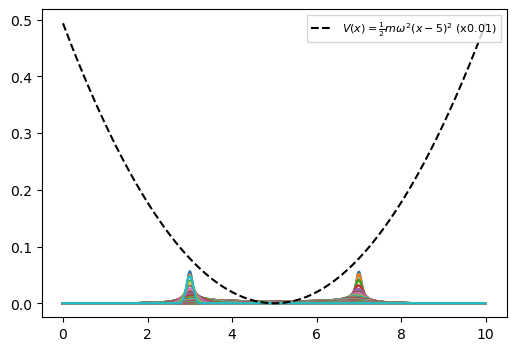

In [ ]:
fig = plt.figure(figsize=(6, 4))
for i, t in enumerate(sol.t):
    plt.plot(x, np.abs(sol.y[:,i])**2*dx)             # Plot Wavefunctions
    print(np.sum(np.abs(sol.y[:,i])**2)*dx)        # Print Total Probability (Should = 1)
plt.plot(x, V * 0.001, "k--", label=r"$V(x) = \frac{1}{2}m\omega^2 (x-5)^2$ (x0.01)")   # Plot Potential
plt.legend(loc=1, fontsize=8, fancybox=False)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


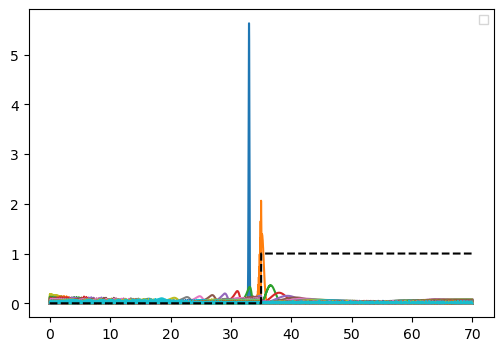

In [385]:
fig = plt.figure(figsize=(6, 4))
for i, y in enumerate(sol2.t):
    plt.plot(x, np.abs(sol2.y[:, i])**2)
plt.plot(x, V2*.001, "k--")   # Plot Potential
plt.legend(loc=1, fontsize=8, fancybox=False)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


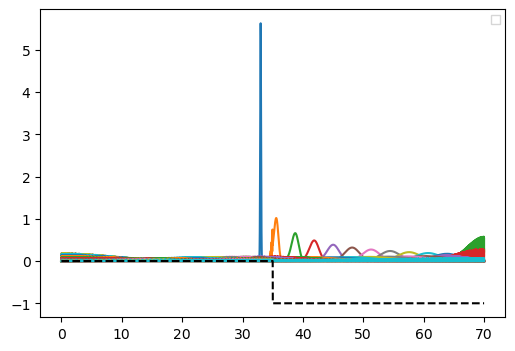

In [386]:
fig = plt.figure(figsize=(6, 4))
for i, y in enumerate(sol3.t):
    plt.plot(x, np.abs(sol3.y[:, i])**2)
plt.plot(x, V3*.001, "k--")   # Plot Potential
plt.legend(loc=1, fontsize=8, fancybox=False)

In [ ]:
# #Animation
# fig = plt.figure()
# ax1 = plt.subplot(1,1,1)
# ax1.set_xlim(0, x_max)
# ax1.set_ylim(0, 1)
# title = ax1.set_title('')
# line1, = ax1.plot([], [], "k--")
# line2, = ax1.plot([], [])

# def init():
#     line1.set_data(x, V*.001)
#     return line1,

# def animate(i):
#     line2.set_data(x, np.abs(sol.y[:, i])**2*dx)
#     title.set_text("Time = {0:1.3f}".format(sol.t[i]))
#     return line1,

# anim = animation.FuncAnimation(fig, animate, init_func=init, frames=len(sol.t), interval=50, blit=True)

# HTML(anim.to_jshtml())

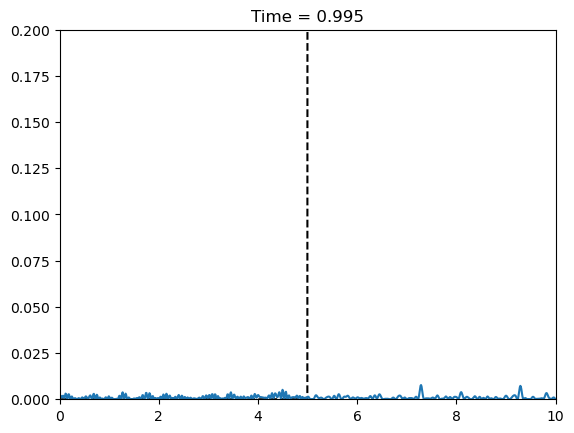

In [ ]:
#Animation
fig = plt.figure()
ax1 = plt.subplot(1,1,1)
ax1.set_xlim(0, x_max)
ax1.set_ylim(0, .2)
title = ax1.set_title('')
line1, = ax1.plot([], [], "k--")
line2, = ax1.plot([], [])

def init():
    line1.set_data(x, V2*.001)
    return line1,

def animate(i):
    line2.set_data(x, np.abs(sol2.y[:, i])**2*dx)
    title.set_text("Time = {0:1.3f}".format(sol2.t[i]))
    return line1,

anim = animation.FuncAnimation(fig, animate, init_func=init, frames=len(sol2.t), interval=50, blit=True)

HTML(anim.to_jshtml())

In [ ]:
# #Animation
# fig = plt.figure()
# ax1 = plt.subplot(1,1,1)
# ax1.set_xlim(0, x_max)
# ax1.set_ylim(-6, 6)
# title = ax1.set_title('')
# line1, = ax1.plot([], [], "k--")
# line2, = ax1.plot([], [])

# def init():
#     line1.set_data(x, V2*.001)
#     return line1,

# def animate(i):
#     line2.set_data(x, np.real(sol2.y[:, i]))
#     title.set_text("Time = {0:1.3f}".format(sol2.t[i]))
#     return line1,

# anim = animation.FuncAnimation(fig, animate, init_func=init, frames=len(sol2.t), interval=50, blit=True)

# HTML(anim.to_jshtml())

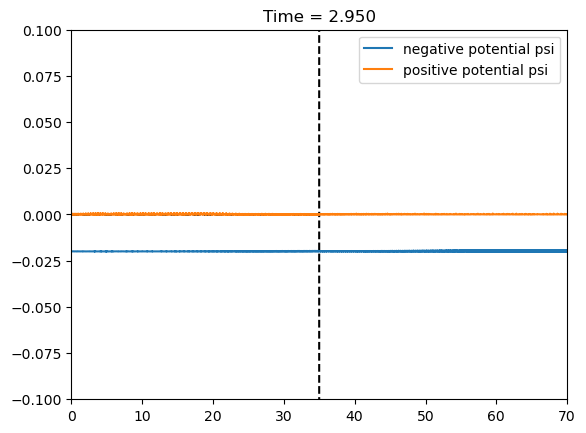

In [387]:
#Animation
fig = plt.figure()
ax1 = plt.subplot(1,1,1)
ax1.set_xlim(0, x_max)
ax1.set_ylim(-.1, .1)
title = ax1.set_title('')
line1, = ax1.plot([], [], "k--")
line2, = ax1.plot([], [], label = 'negative potential psi')
line3, = ax1.plot([], [], "k--")
line4, = ax1.plot([], [], label = 'positive potential psi')

def init():
    line1.set_data(x, V3*.001)
    line3.set_data(x, V2*.001)
    return line1, line3

def animate(i):
    line2.set_data(x, np.abs(sol3.y[:, i])**2*dx-.02)
    line4.set_data(x, np.abs(sol2.y[:, i])**2*dx)
    title.set_text("Time = {0:1.3f}".format(sol3.t[i]))
    return line1, line3,

anim = animation.FuncAnimation(fig, animate, init_func=init, frames=len(sol3.t), interval=500, blit=True)

ax1.legend()
HTML(anim.to_jshtml())

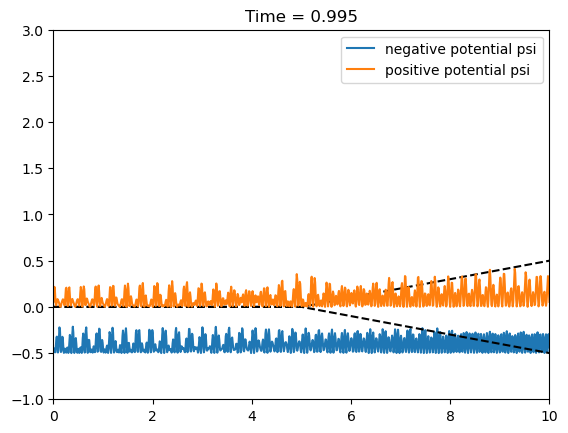

In [ ]:
#Animation
fig = plt.figure()
ax1 = plt.subplot(1,1,1)
ax1.set_xlim(0, x_max)
ax1.set_ylim(-1, 3)
title = ax1.set_title('')
line1, = ax1.plot([], [], "k--")
line2, = ax1.plot([], [], label = 'negative potential psi')
line3, = ax1.plot([], [], "k--")
line4, = ax1.plot([], [], label = 'positive potential psi')

def init():
    line1.set_data(x, Vslant*.001)
    line3.set_data(x, -Vslant*.001)
    return line1, line3

def animate(i):
    line2.set_data(x, np.abs(sol_slant_neg.y[:, i])**2-.5)
    line4.set_data(x, np.abs(sol_slant_pos.y[:, i])**2)
    title.set_text("Time = {0:1.3f}".format(sol3.t[i]))
    return line1, line3,

anim = animation.FuncAnimation(fig, animate, init_func=init, frames=len(sol_slant_pos.t), interval=50, blit=True)

ax1.legend()
HTML(anim.to_jshtml())

C:\Users\natha\AppData\Local\Temp\ipykernel_53212\2025186009.py:2: RuntimeWarning: invalid value encountered in true_divide
  diff = ((np.abs(sol2.y)**2 - np.abs(sol3.y)**2) / (np.abs(sol2.y)**2 + np.abs(sol3.y)**2))


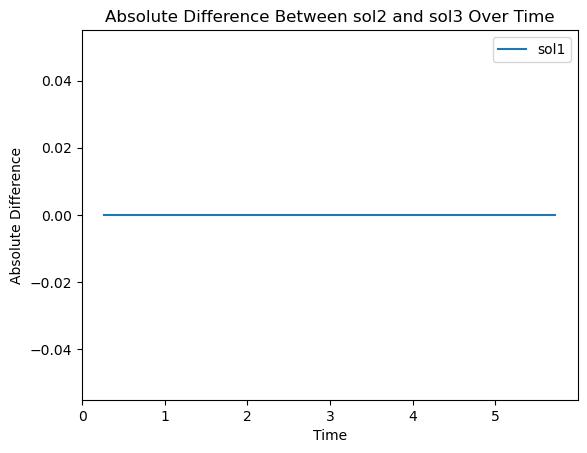

In [ ]:
# Calculate the absolute value of the difference between sol2 and sol3
diff = ((np.abs(sol2.y)**2 - np.abs(sol3.y)**2) / (np.abs(sol2.y)**2 + np.abs(sol3.y)**2))

# Plot the result
plt.figure()
plt.plot(x, diff[:, 0], label=f'sol{0+1}')
plt.xlabel('Time')
plt.ylabel('Absolute Difference')
plt.title('Absolute Difference Between sol2 and sol3 Over Time')
plt.legend()
plt.show()

In [ ]:
# #Animation
# fig = plt.figure()
# ax1 = plt.subplot(1,1,1)
# ax1.set_xlim(0, x_max)
# ax1.set_ylim(-1.5, 1.5)
# title = ax1.set_title('')
# line1, = ax1.plot([], [], "k--")
# line2, = ax1.plot([], [])

# def init():
#     line1.set_data(x, V2*.001)
#     return line1,

# def animate(i):
#     line2.set_data(x, diff[:, i])
#     title.set_text("Time = {0:1.3f}".format(sol2.t[i]))
#     return line1,

# anim = animation.FuncAnimation(fig, animate, init_func=init, frames=len(sol2.t), interval=50, blit=True)

# HTML(anim.to_jshtml())

KeyboardInterrupt: 

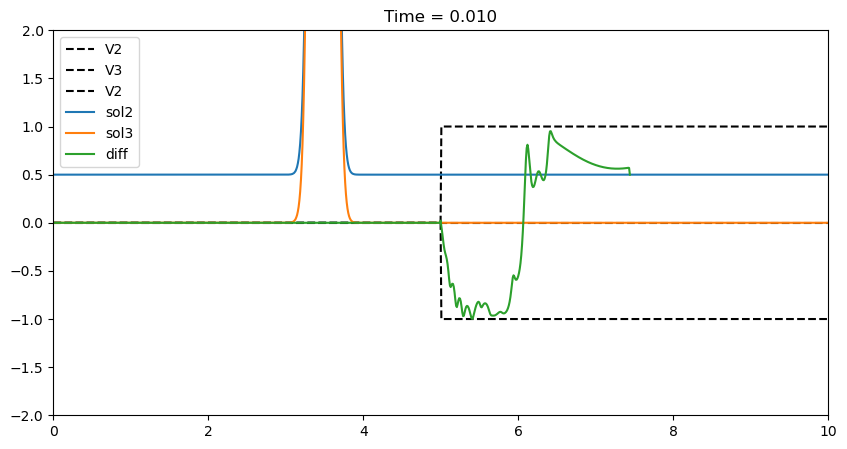

In [ ]:
# Create a figure with a single subplot
fig, ax = plt.subplots(figsize=(10, 5))

# Set the limits and title for the subplot
ax.set_xlim(0, x_max)
ax.set_ylim(-2, 2)
title = ax.set_title('')

# Initialize three lines for the potential V2 and V3
line1, = ax.plot([], [], "k--", label='V2')
line2, = ax.plot([], [], "k--", label='V3')
line3, = ax.plot([], [], "k--", label='V2')

# Initialize three more lines for the solutions sol2, sol3 and diff
line4, = ax.plot([], [], label='sol2')
line5, = ax.plot([], [], label='sol3')
line6, = ax.plot([], [], label='diff')

def init():
    line1.set_data(x, V2*.001)
    line2.set_data(x, V3*.001)
    line3.set_data(x, 0)
    return line1, line2, line3,

def animate(i):
    line4.set_data(x, 10*np.abs(sol2.y[:, i])**2+.5)
    line5.set_data(x, 10*np.abs(sol3.y[:, i])**2)
    line6.set_data(x, diff[:, i])
    title.set_text("Time = {0:1.3f}".format(sol2.t[i]))
    return line4, line5, line6,

# Create the animation
anim = animation.FuncAnimation(fig, animate, init_func=init, frames=len(sol2.t), interval=50, blit=True)

# Add a legend
ax.legend()

# Display the animation
HTML(anim.to_jshtml())